In [4]:
import os
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.signal import find_peaks_cwt

In [5]:
### 1 UNDISTORTION
# 1.1 SHOW CHESSBOARD WITH CONERS

In [6]:
def show_two_imgs(img1, img2, title1, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img1)
    ax1.set_title(title1, fontsize=40)
    
    ax2.imshow(img2)
    ax2.set_title(title2, fontsize=40)  
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

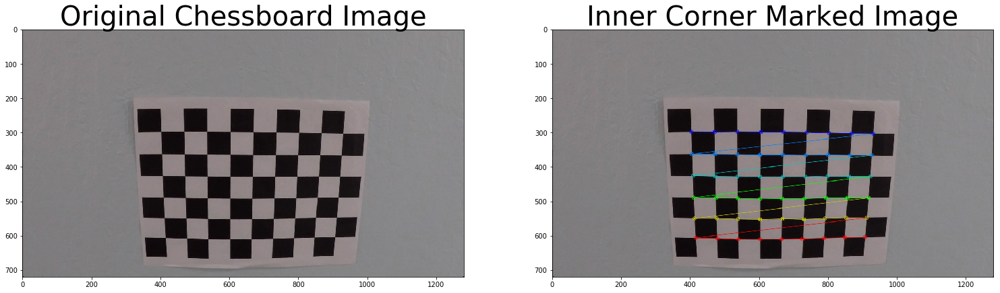

In [7]:
# Load chessboard images
fname = 'camera_cal/calibration{}.jpg'.format(17)
img = cv2.imread(fname)

# prepare object points
nx = 9 # The number of inside corners in x (rows)
ny = 6 # The number of inside corners in y (cols)

# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Find the chessboard corners
ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

%matplotlib inline

# If found, draw corners
if ret == True:
    # Draw and display the corners
    img1 = np.copy(img)
    img2 = cv2.drawChessboardCorners(img1, (nx, ny), corners, ret)
    title1 = 'Original Chessboard Image'
    title2 = 'Inner Corner Marked Image'
    show_two_imgs(img, img2, title1, title2)

In [8]:
# 1.2 PRECESS ALL 20 IMAGES

In [9]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....
objp = np.zeros((nx*ny,3), np.float32)
print("created [[0,0,0],...]")
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
print("created [0,0,0],[1,0,0],...")
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.


created [[0,0,0],...]
created [0,0,0],[1,0,0],...


In [10]:
# Step through the list and search for chessboard corners
for i in range(1,21):
    fname = 'camera_cal/calibration{}.jpg'.format(i)
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        print(fname)
        objpoints.append(objp)
        imgpoints.append(corners)


camera_cal/calibration2.jpg
camera_cal/calibration3.jpg
camera_cal/calibration6.jpg
camera_cal/calibration7.jpg
camera_cal/calibration8.jpg
camera_cal/calibration9.jpg
camera_cal/calibration10.jpg
camera_cal/calibration11.jpg
camera_cal/calibration12.jpg
camera_cal/calibration13.jpg
camera_cal/calibration14.jpg
camera_cal/calibration15.jpg
camera_cal/calibration16.jpg
camera_cal/calibration17.jpg
camera_cal/calibration18.jpg
camera_cal/calibration19.jpg
camera_cal/calibration20.jpg


In [11]:
# 1.3 UNDISTORTION

In [12]:
# Test undistortion on an image
fname = 'camera_cal/calibration{}.jpg'.format(2)
img = cv2.imread(fname)
img_size = (img.shape[1], img.shape[0])

In [13]:
# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

dst = cv2.undistort(img, mtx, dist, None, mtx)
#cv2.imwrite('output_images/test_undist.jpg',dst)

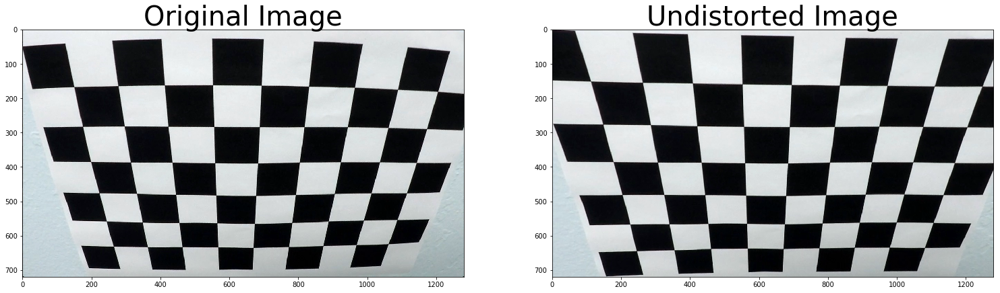

In [14]:
# Save the camera calibration result for later use
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) )

# Visualize undistortion
%matplotlib inline

show_two_imgs(img, dst, 'Original Image', 'Undistorted Image')

In [15]:
### 2 PIPLINE CONSTRUCTION
# 2.1 Find Region of Interest

In [16]:
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [17]:
# 2.2 Calculate directional gradient
def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute values
    sobel = np.absolute(sobel)
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*sobel/np.max(sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    # Return the result
    return binary_output

In [18]:
# 2.3 Calculate gradient magnitude
def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    # Apply x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    sobel = np.sqrt(sobelx ** 2 + sobely ** 2)
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*sobel/np.max(sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > mag_thresh[0]) & (scaled_sobel < mag_thresh[1])] = 1
    # Return the result
    return binary_output

In [19]:
# 2.4 Calculate gradient direction
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Error statement to ignore division and invalid errors
    with np.errstate(divide='ignore', invalid='ignore'):
        absgraddir = np.absolute(np.arctan(sobely/sobelx))
        dir_binary =  np.zeros_like(absgraddir)
        dir_binary[(absgraddir > thresh[0]) & (absgraddir < thresh[1])] = 1
    # Return the result
    return dir_binary

In [20]:
# 2.5 Create Pipline
def pipeline(img):     
    # Gaussian Blur
    kernel_size = 5
    img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define sobel kernel size
    ksize = 7
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(10, 255))
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(60, 255))
    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(40, 255))
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.65, 1.05))
    # Combine all the thresholding information
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    # Threshold color channel
    s_binary = np.zeros_like(combined)
    s_binary[(s > 160) & (s < 255)] = 1
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors    
    color_binary = np.zeros_like(combined)
    color_binary[(s_binary > 0) | (combined > 0)] = 1
    # Defining vertices for marked area
    imshape = img.shape
    left_bottom = (100, imshape[0])
    right_bottom = (imshape[1]-20, imshape[0])
    apex1 = (610, 410)
    apex2 = (680, 410)
    inner_left_bottom = (310, imshape[0])
    inner_right_bottom = (1150, imshape[0])
    inner_apex1 = (700,480)
    inner_apex2 = (650,480)
    vertices = np.array([[left_bottom, apex1, apex2, \
                          right_bottom, inner_right_bottom, \
                          inner_apex1, inner_apex2, inner_left_bottom]], dtype=np.int32)
    # Masked area
    color_binary = region_of_interest(color_binary, vertices)
    return color_binary

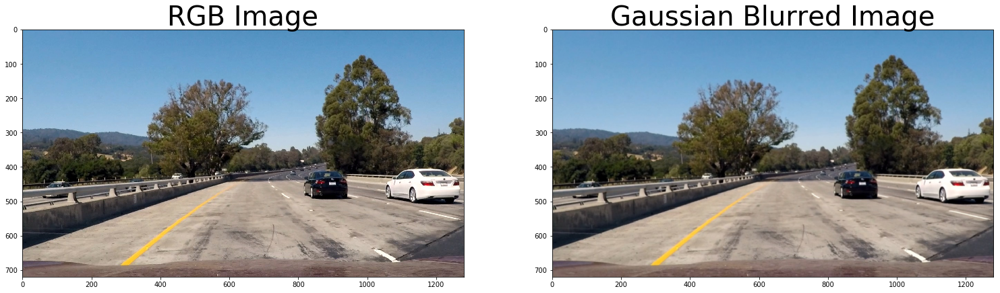

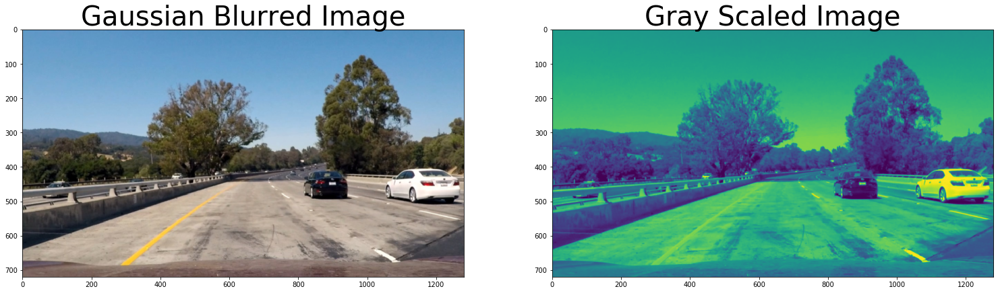

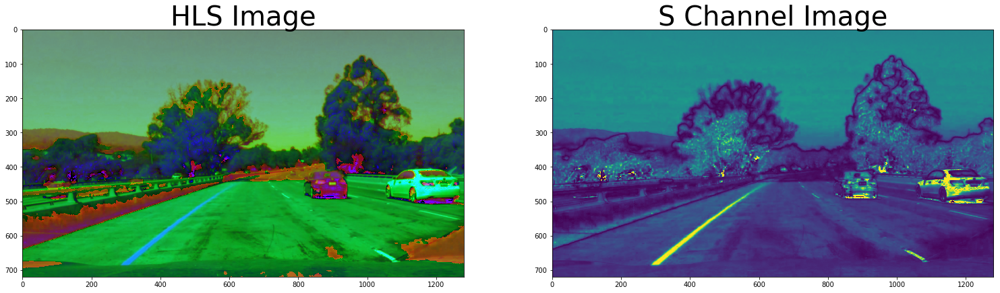

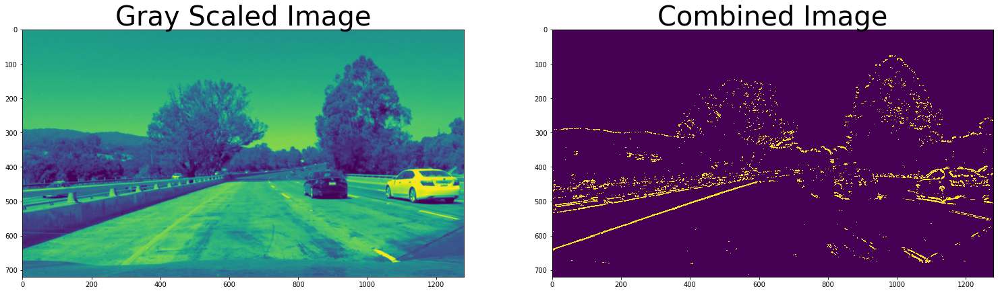

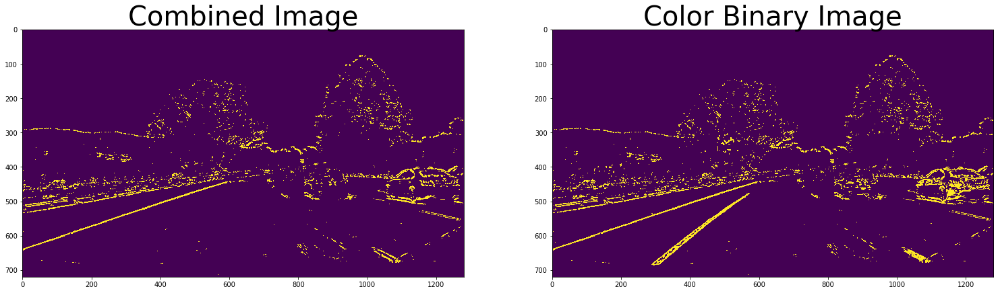

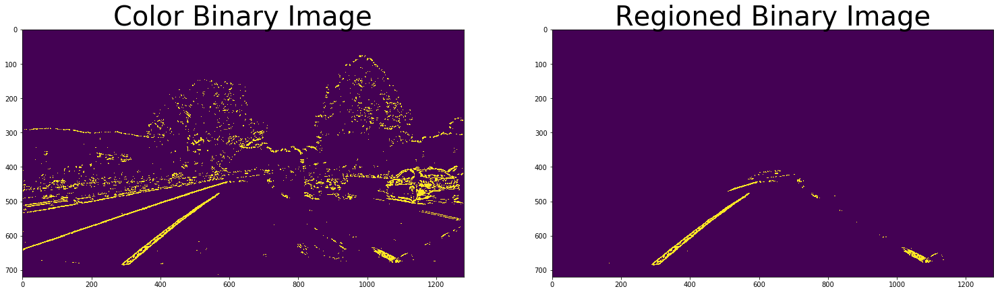

In [21]:
# 2.6 Show the Pipeline Precess 
# Use test1.jpg as an example
fname = 'test_images/test1.jpg'
p_input = cv2.imread(fname)
p_input = cv2.cvtColor(p_input,cv2.COLOR_BGR2RGB)
kernel_size = 5
gb = cv2.GaussianBlur(p_input, (kernel_size, kernel_size), 0)
show_two_imgs(p_input, gb, 'RGB Image', 'Gaussian Blurred Image')

gray = cv2.cvtColor(gb, cv2.COLOR_RGB2GRAY)
show_two_imgs(gb, gray, 'Gaussian Blurred Image', 'Gray Scaled Image')

hls = cv2.cvtColor(gb, cv2.COLOR_RGB2HLS)
s = hls[:,:,2]
show_two_imgs(hls, s, 'HLS Image', 'S Channel Image')

ksize = 7
gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(10, 255))
grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(60, 255))
mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(40, 255))
dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.65, 1.05))
combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
show_two_imgs(gray, combined, 'Gray Scaled Image', 'Combined Image')

s_binary = np.zeros_like(combined)
s_binary[(s > 160) & (s < 255)] = 1
color_binary = np.zeros_like(combined)
color_binary[(s_binary > 0) | (combined > 0)] = 1
show_two_imgs(combined, color_binary, 'Combined Image', 'Color Binary Image')

imshape = p_input.shape
left_bottom = (100, imshape[0])
right_bottom = (imshape[1]-20, imshape[0])
apex1 = (610, 410)
apex2 = (680, 410)
inner_left_bottom = (310, imshape[0])
inner_right_bottom = (1150, imshape[0])
inner_apex1 = (700,480)
inner_apex2 = (650,480)
vertices = np.array([[left_bottom, apex1, apex2, \
                          right_bottom, inner_right_bottom, \
                          inner_apex1, inner_apex2, inner_left_bottom]], dtype=np.int32)
color_binary_region = region_of_interest(color_binary, vertices)
show_two_imgs(color_binary, color_binary_region, 'Color Binary Image', 'Regioned Binary Image')


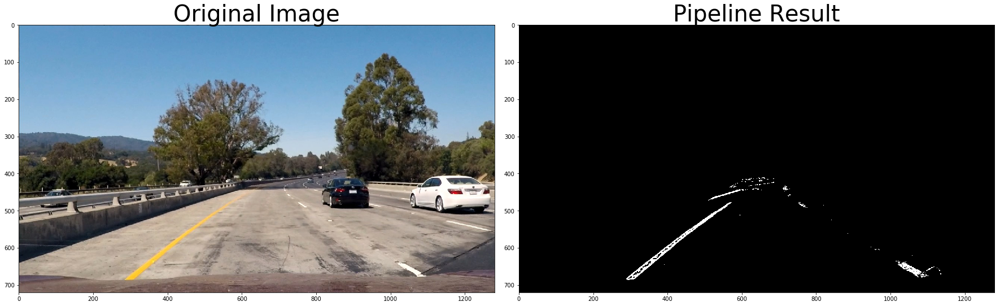

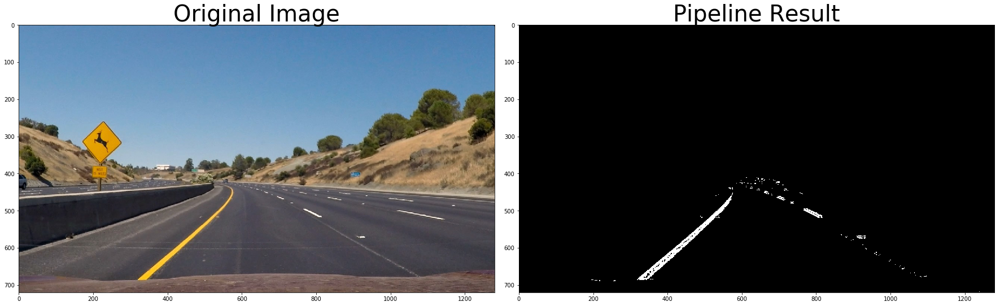

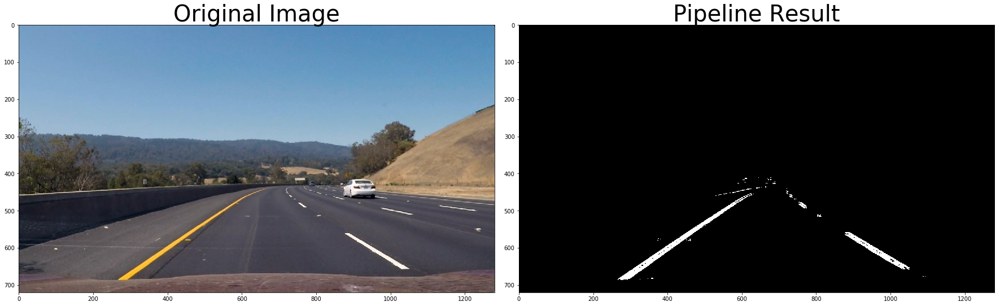

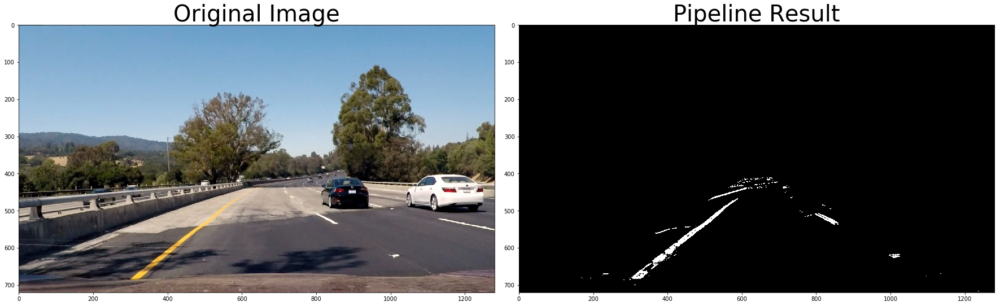

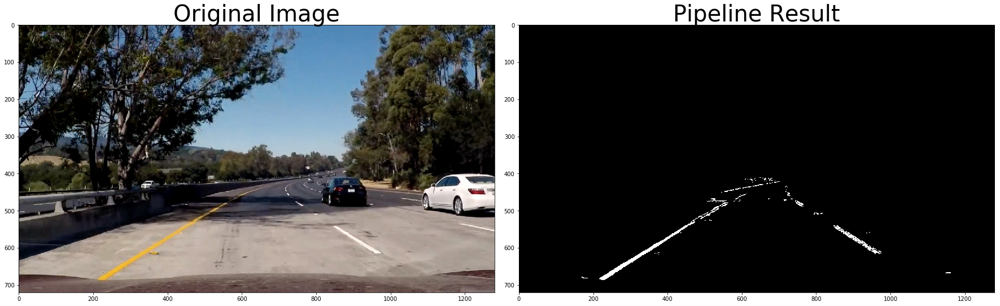

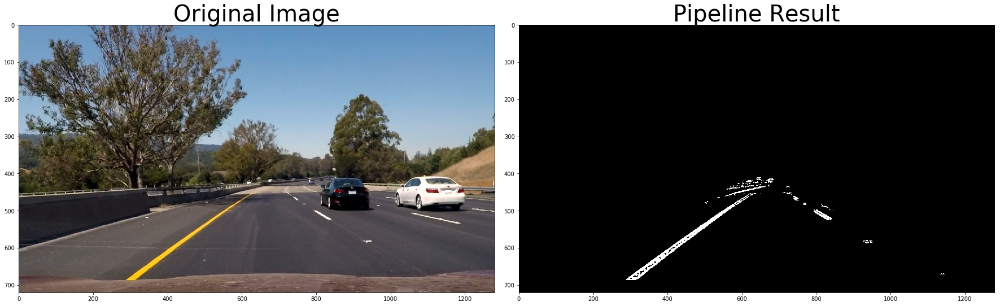

In [22]:
# 2.7 Apply Pipeline to all the test images
for i in range(1,7):
    fname = 'test_images/test{}.jpg'.format(i)
    image = cv2.imread(fname)
    image_rgb = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    result = pipeline(image)

    %matplotlib inline

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(image_rgb)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=40)
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

In [23]:
### 3 UNDISTORTION AND WARP

In [24]:
# Define image shape
img_shape = image.shape
print("image shape:",img_shape)

# Define the region
area_of_interest = [[575,460],[700,460],[1080,680],[250,680]]
offset = 240
# Grab the image shape
img_size = (img.shape[1], img.shape[0])
# For source points I'm grabbing the outer four detected corners
src = np.float32(area_of_interest)
# For destination points, I'm arbitrarily choosing some points to be
# a nice fit for displaying our warped result 
dst = np.float32([[0+offset, 0],
                [img_shape[1]-offset, 0],
                [img_shape[1]-offset, img_shape[0]],
                [0+offset, img_shape[0]]])
def get_warp_M_Minv(src,dst):
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    return M,Minv

M,Minv = get_warp_M_Minv(src,dst)

def undist_warp(img, mtx, dist):  
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)
    # Return the resulting image and matrix
    return warped

print(area_of_interest)
print(dst)

image shape: (720, 1280, 3)
[[575, 460], [700, 460], [1080, 680], [250, 680]]
[[  240.     0.]
 [ 1040.     0.]
 [ 1040.   720.]
 [  240.   720.]]


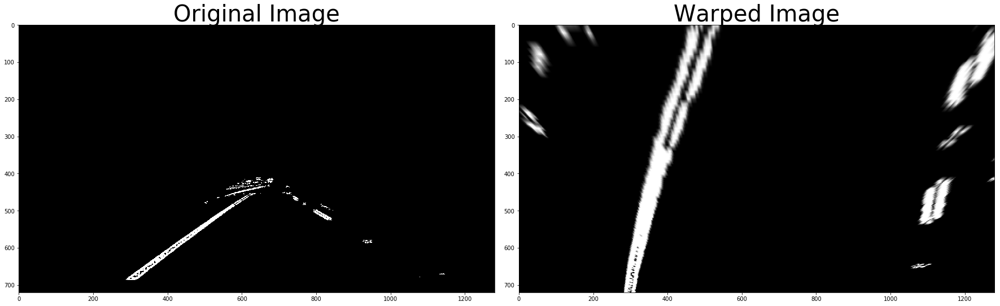

In [25]:
    %matplotlib inline

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(result, cmap='gray')
    ax1.set_title('Original Image', fontsize=40)

    bi_warped = undist_warp(result, mtx, dist)
    ax2.imshow(bi_warped, cmap='gray')
    ax2.set_title('Warped Image', fontsize=40)
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

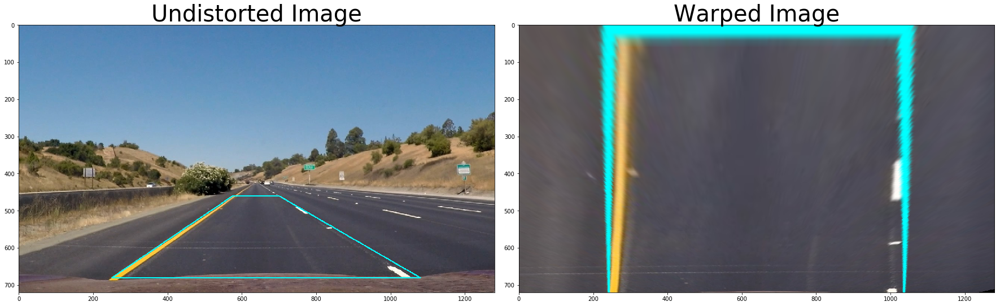

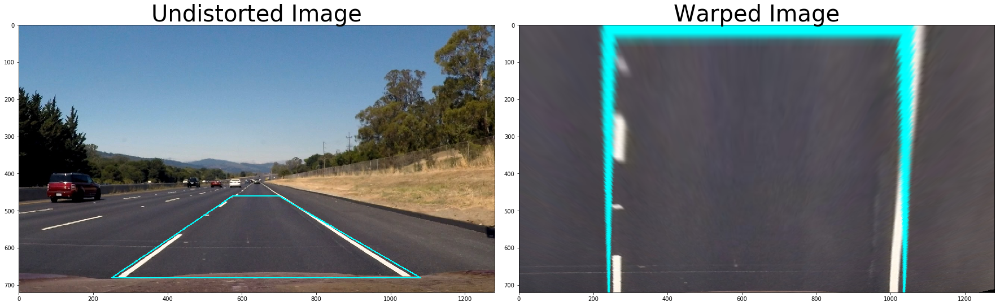

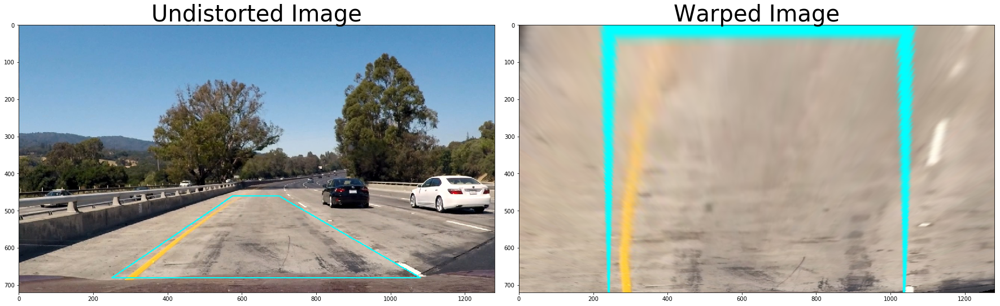

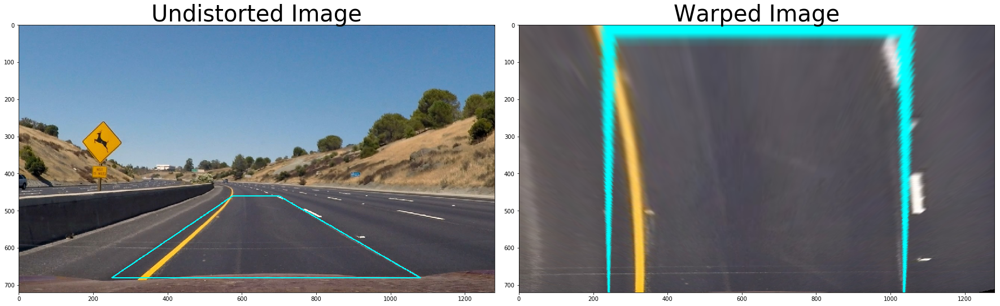

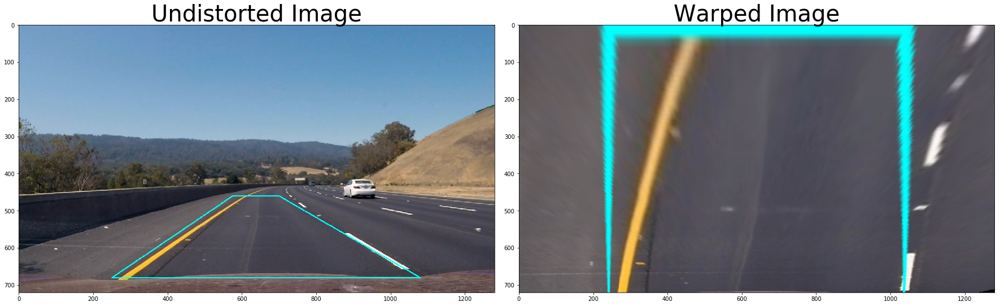

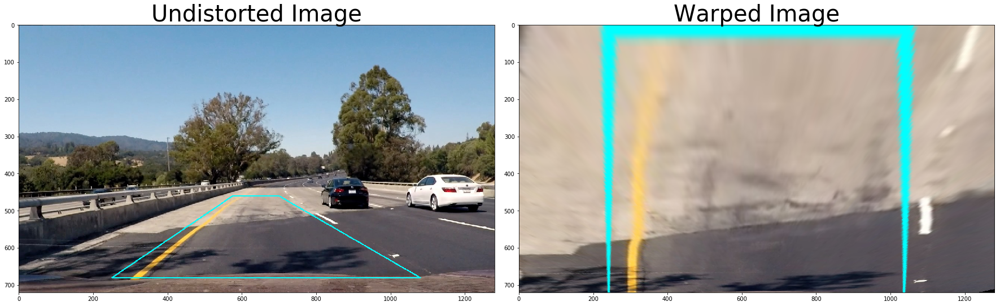

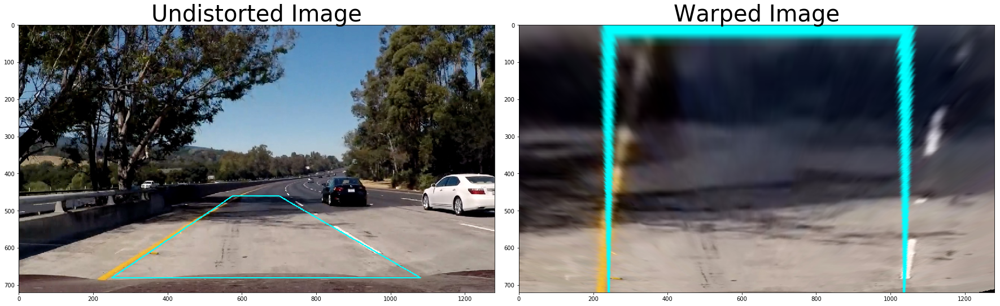

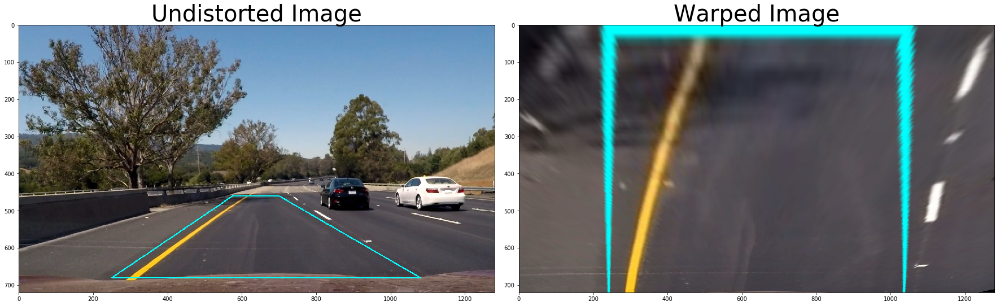

In [26]:
images = os.listdir('./test_images')  
#print(images)
for fname in images:
    fname = os.path.join('test_images',fname)
    #print(fname)
    img = mpimg.imread(fname)
    pts = np.array(area_of_interest, np.int32)
    pts = pts.reshape((-1,1,2))
    cv2.polylines(img,[pts],True,(0,255,255),2)    
    warped = undist_warp(img, mtx, dist)
    
    %matplotlib inline
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(img)
    ax1.set_title('Undistorted Image', fontsize=40)
    
    ax2.imshow(warped)
    ax2.set_title('Warped Image', fontsize=40)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

In [27]:
### 4. Find Lanes

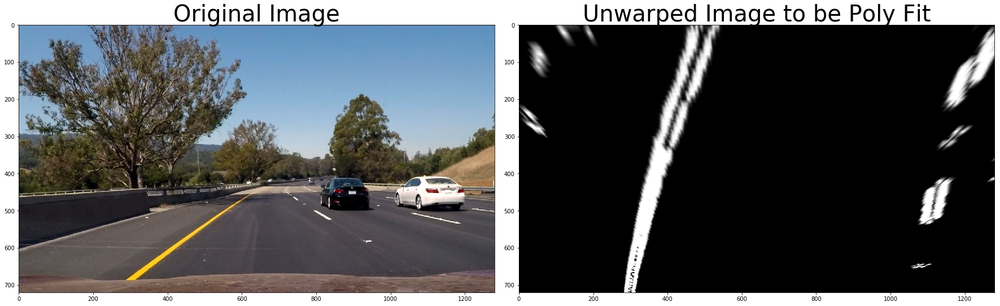

In [28]:
fname = 'test_images/test6.jpg'
image = cv2.imread(fname)
image_rgb = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
bi_image = pipeline(image)

%matplotlib inline

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
    
ax1.imshow(image_rgb)
ax1.set_title('Original Image', fontsize=40)

bi_un_warped = undist_warp(bi_image, mtx, dist)

ax2.imshow(bi_un_warped, cmap='gray')
ax2.set_title('Unwarped Image to be Poly Fit', fontsize=40)
   
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [29]:
# 4.1 Polyfit and Visualization

In [30]:
# Create arrays as the result of the find_equations from last 10 picture frames

In [168]:
temp_left_fitx = []
temp_right_fitx = []
def find_equations(binary_warped, last_10_leftx, last_10_rightx):
    global temp_left_fitx
    global temp_right_fitx
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    
    if len(leftx) == 0 or len(rightx) == 0:
        dem_l = len(last_10_leftx)
        dem_r = len(last_10_rightx)
        if len(last_10_leftx) == 0:
            dem_l = 1
        if len(last_10_rightx) == 0:
            dem_r = 1
        return binary_warped, sum(last_10_leftx)/dem_l, sum(last_10_rightx)/dem_r, ploty  
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Record whatever value if got in current image
    temp_left_fitx.append(left_fitx)
    #print(len(temp_left_fitx))
    temp_right_fitx.append(right_fitx)
    
    # Adding smooth precess for finding fitx left and right
    if len(temp_left_fitx) > 14:
        temp_left_fitx = temp_left_fitx[-15:]
        #len(temp_left_fitx)
    left_fitx = sum(last_10_leftx)/(len(last_10_leftx))

    if len(temp_right_fitx) > 14:
        temp_right_fitx = temp_right_fitx[-15:]
    right_fitx = sum(temp_right_fitx)/(len(temp_right_fitx))
    
    #print(len(last_10_rightx))
    
    return result, left_fitx, right_fitx, ploty

In [169]:
# 4.3 Test Lane Finding

(720, 0)

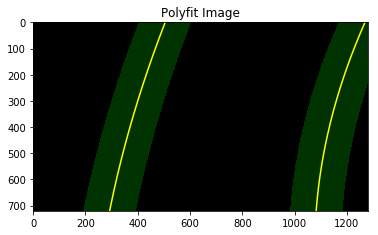

In [170]:
result, left_fitx, right_fitx, ploty = find_equations(bi_un_warped,temp_left_fitx,temp_right_fitx)

plt.imshow(result)
plt.title('Polyfit Image')
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [171]:
### 5.Draw the Lines Back Into the Original Image

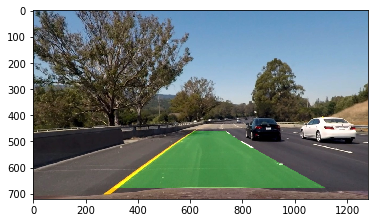

In [172]:
# Create an image to draw the lines on
image_test = image_rgb
warped = bi_un_warped
    
undist = cv2.undistort(image_test, mtx, dist, None, mtx)

warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
plt.imshow(result)

In [173]:
### 6.Find Curvature

In [174]:
def find_curvature(yvals, fitx):
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(yvals)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    fit_cr = np.polyfit(yvals*ym_per_pix, fitx*xm_per_pix, 2)
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*fit_cr[0])
    return curverad

left_curverad = find_curvature(ploty,left_fitx)
right_curverad = find_curvature(ploty,right_fitx)
# Now our radius of curvature is in meters
print('left curverad: ', left_curverad, 'm, \nright curverad: ', right_curverad, 'm')

left curverad:  1270.61630968 m, 
right curverad:  645.387040225 m


In [175]:
### 7.Find Car Position

In [176]:
def find_position(image, left_fitx, right_fitx):
    # Find the position of the car from the center
    # It will show if the car is 'x' meters from the left or right
    left_mean = np.mean(left_fitx)
    right_mean = np.mean(right_fitx)
    camera_pos = (image.shape[1]/2)-np.mean([left_mean, right_mean])
    # Define conversions in x and y from pixels space to meters
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension    
    return camera_pos*xm_per_pix

In [177]:
### 8. Combine 5,6,7 into One Image with Curvature and Postion information

In [178]:
def draw_into_origin(image, warped, left_fitx, right_fitx, ploty):
    
    undist = cv2.undistort(image, mtx, dist, None, mtx)

    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    left_curverad = find_curvature(ploty,left_fitx)
    right_curverad = find_curvature(ploty,right_fitx)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    text1 = "Left Line Curvature Radius: {} m".format(int(left_curverad))
    text2 = "Right Line Curvature Radius: {} m".format(int(right_curverad))    
    cv2.putText(result,text1,(350,100), font, 1,(255,255,255),2)
    cv2.putText(result,text2,(350,150), font, 1,(255,255,255),2)
    
    position = find_position(undist, left_fitx, right_fitx)

    if position < 0:
        text = "Vehicle is {:.2f}m left from center".format(-position)
    else:
        text = "Vehicle is {:.2f}m right from center".format(position)
    cv2.putText(result,text,(350,200), font, 1,(255,255,255),2)

    return result

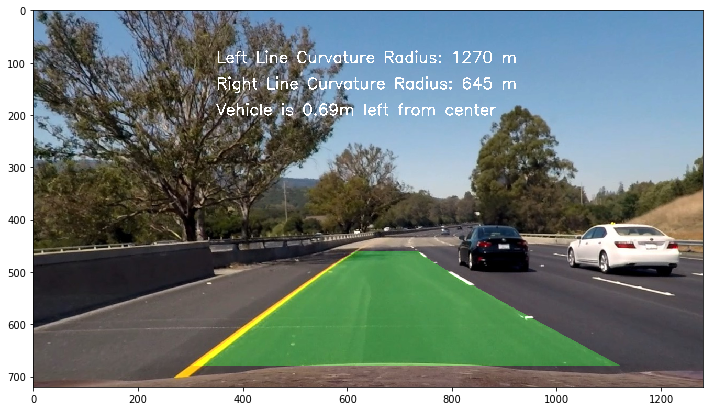

In [179]:
#Test the draw into original flow
result = draw_into_origin(image_rgb, bi_un_warped, left_fitx, right_fitx, ploty)
fig, ax = plt.subplots(figsize=(12, 9))
ax.imshow(result)

In [180]:
### 9.Put Everything Together to Process Image

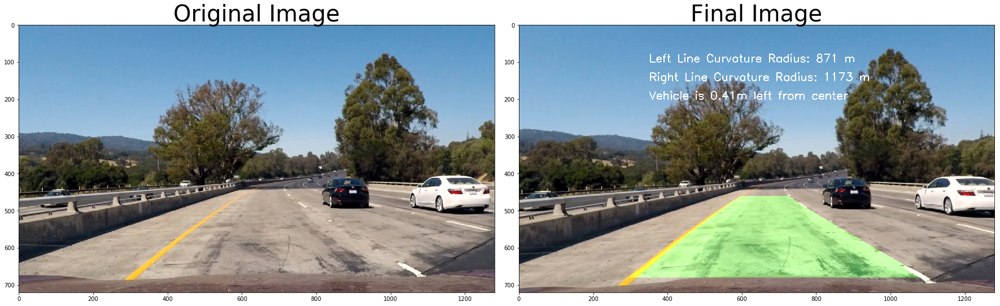

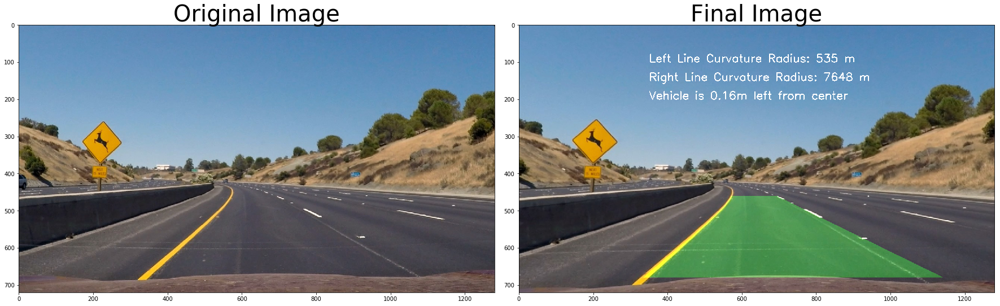

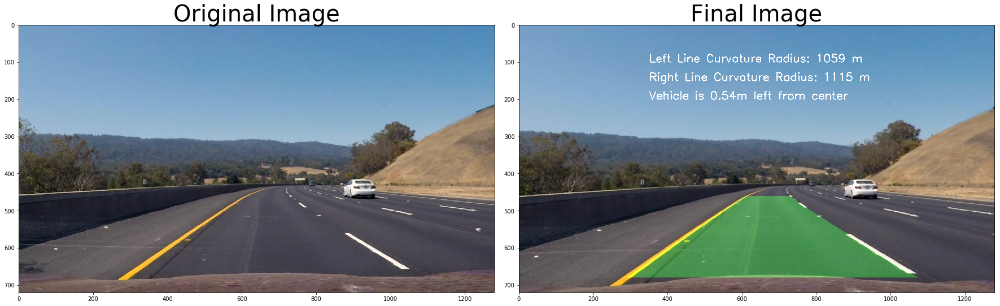

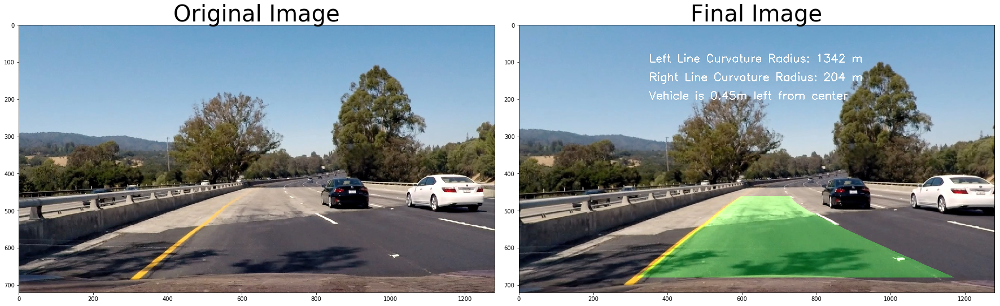

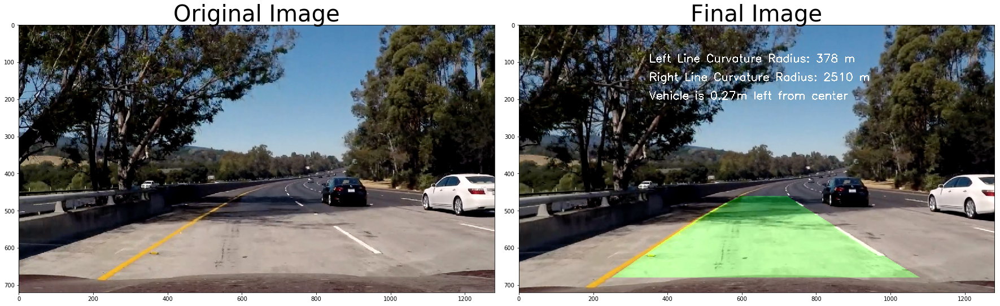

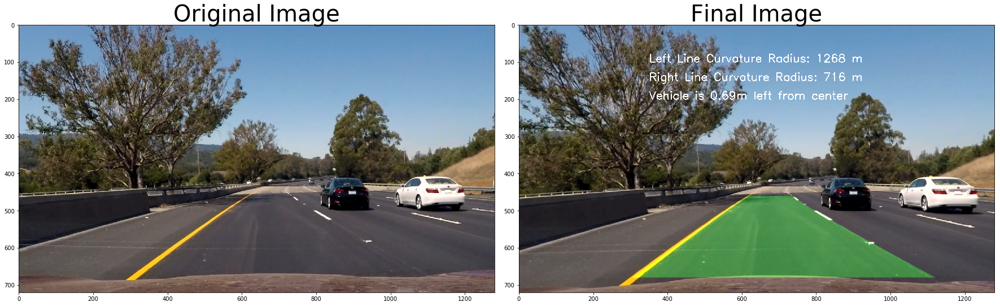

In [181]:
def process_image(clip):
    '''
    #1. get rgb image
    image_rgb = cv2.cvtColor(clip, cv2.COLOR_BGR2RGB)
    '''
    #2. find binary image
    bi_image = pipeline(clip)
    #3. undistort and warp
    bi_un_warped = undist_warp(bi_image, mtx, dist)
    #3. find lane line info
    temp_img, left_fitx, right_fitx, ploty = find_equations(bi_un_warped,temp_left_fitx,temp_right_fitx)
    #4. draw/ polyfill the area and extra information back to the undistorted image
    result = draw_into_origin(clip, bi_un_warped, left_fitx, right_fitx, ploty)
    return result

# Plot the result
for i in range(1,7):
    fname = 'test_images/test{}.jpg'.format(i)
    image = cv2.imread(fname)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(image_rgb)
    ax1.set_title('Original Image', fontsize=40)

    temp_left_fitx = []
    temp_right_fitx = []
    res = process_image(image_rgb)

    ax2.imshow(res, cmap='gray')
    ax2.set_title('Final Image', fontsize=40)
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [182]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

temp_left_fitx = []
temp_right_fitx = []
write_output = 'project_video_out.mp4'
clip1 = VideoFileClip("project_video.mp4")
##clip = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
write_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time write_clip.write_videofile(write_output, audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4







  0%|          | 0/1261 [00:00<?, ?it/s]




  0%|          | 1/1261 [00:00<11:32,  1.82it/s]




  0%|          | 2/1261 [00:01<11:09,  1.88it/s]




  0%|          | 3/1261 [00:01<10:56,  1.92it/s]




  0%|          | 4/1261 [00:01<10:11,  2.06it/s]




  0%|          | 5/1261 [00:02<09:38,  2.17it/s]




  0%|          | 6/1261 [00:02<09:18,  2.25it/s]




  1%|          | 7/1261 [00:03<09:16,  2.25it/s]




  1%|          | 8/1261 [00:03<09:03,  2.31it/s]




  1%|          | 9/1261 [00:04<08:55,  2.34it/s]




  1%|          | 10/1261 [00:04<08:40,  2.40it/s]




  1%|          | 11/1261 [00:04<08:27,  2.46it/s]




  1%|          | 12/1261 [00:05<08:22,  2.48it/s]




  1%|          | 13/1261 [00:05<08:20,  2.49it/s]




  1%|          | 14/1261 [00:05<08:18,  2.50it/s]




  1%|          | 15/1261 [00:06<08:22,  2.48it/s]




  1%|▏         | 16/1261 [00:06<08:31,  2.43it/s]




  1%|▏         | 17/1261 [00:07<08:34,  2.42it/s]




  1%|▏         | 18/1261 [00:07<08:35,  2

[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 7min 13s, sys: 2min 19s, total: 9min 33s
Wall time: 8min 41s


In [183]:
'''
temp_left_fitx = []
temp_right_fitx = []
write_output = 'challenge_video_out.mp4'
clip1 = VideoFileClip("challenge_video.mp4")
##clip = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
write_clip = clip1.fl_image(process_image).subclip(0,3) #NOTE: this function expects color images!!
%time write_clip.write_videofile(write_output, audio=False)

SyntaxError: EOF while scanning triple-quoted string literal (<ipython-input-183-3c1496a59613>, line 8)

In [ ]:
'''
temp_left_fitx = []
temp_right_fitx = []
write_output = 'harder_challenge_video_out.mp4'
clip1 = VideoFileClip("harder_challenge_video.mp4")
##clip = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
write_clip = clip1.fl_image(process_image).subclip(0,10) #NOTE: this function expects color images!!
%time write_clip.write_videofile(write_output, audio=False)